In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# installing the Kaggle library
!pip install kaggle

In [ ]:
# configuring the path of Kaggle.json file
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
# Kaggle api
!kaggle competitions download -c dogs-vs-cats

dogs-vs-cats.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
!ls

dogs-vs-cats.zip  image_resized  sample_data	       test1.zip  train.zip
drive		  kaggle.json	 sampleSubmission.csv  train


In [ ]:
# extracting the compressed dataset
from zipfile import ZipFile

dataset = '/content/dogs-vs-cats.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
# extracting the compressed dataset
from zipfile import ZipFile

dataset = '/content/train.zip'

with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
import os
# counting the number of files in train folder
path, dirs, files = next(os.walk('/content/train'))
file_count = len(files)
print('Number of images: ', file_count)

Number of images:  25000


In [ ]:
file_names = os.listdir('/content/train/')
print(file_names)

['dog.6504.jpg', 'cat.8895.jpg', 'dog.4758.jpg', 'cat.12147.jpg', 'cat.7323.jpg', 'dog.2994.jpg', 'dog.2395.jpg', 'cat.7072.jpg', 'cat.1848.jpg', 'dog.2146.jpg', 'cat.2032.jpg', 'dog.5988.jpg', 'cat.2333.jpg', 'cat.9816.jpg', 'dog.3208.jpg', 'cat.10289.jpg', 'cat.7924.jpg', 'cat.8847.jpg', 'dog.6554.jpg', 'dog.12476.jpg', 'cat.3286.jpg', 'cat.11233.jpg', 'dog.10247.jpg', 'cat.5436.jpg', 'dog.9262.jpg', 'cat.1031.jpg', 'dog.11735.jpg', 'dog.4975.jpg', 'dog.1372.jpg', 'dog.954.jpg', 'dog.9352.jpg', 'cat.11947.jpg', 'cat.76.jpg', 'cat.9051.jpg', 'dog.6386.jpg', 'dog.11634.jpg', 'dog.8484.jpg', 'dog.7236.jpg', 'dog.8444.jpg', 'cat.2602.jpg', 'dog.11096.jpg', 'dog.7847.jpg', 'cat.11615.jpg', 'cat.3481.jpg', 'cat.11941.jpg', 'cat.11016.jpg', 'dog.8851.jpg', 'cat.3043.jpg', 'dog.1502.jpg', 'cat.10729.jpg', 'cat.10265.jpg', 'cat.3351.jpg', 'cat.9004.jpg', 'dog.1406.jpg', 'dog.5938.jpg', 'cat.7456.jpg', 'cat.8999.jpg', 'cat.12121.jpg', 'cat.9034.jpg', 'cat.5373.jpg', 'cat.12366.jpg', 'dog.3805.

In [ ]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
from google.colab.patches import cv2_imshow

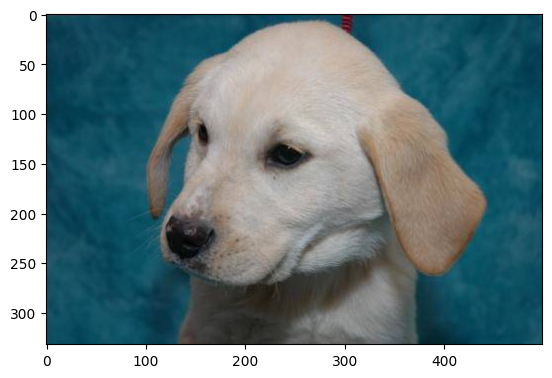

In [ ]:
# display dog image
img = mpimg.imread('/content/train/dog.2994.jpg')
imgplt = plt.imshow(img)
plt.show()

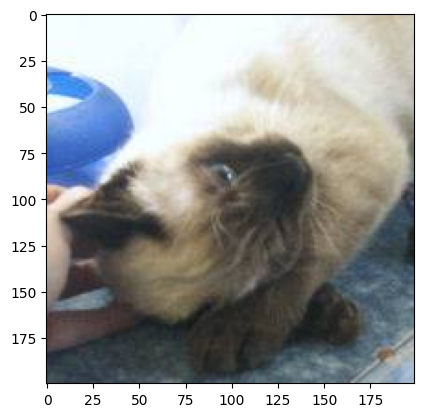

In [ ]:
# display cat image
img = mpimg.imread('/content/train/cat.7323.jpg')
imgplt = plt.imshow(img)
plt.show()

In [ ]:
file_names = os.listdir('/content/train/')

for i in range(5):

  name = file_names[i]
  print(name[0:3])

dog
cat
dog
cat
cat


In [ ]:
file_names = os.listdir('/content/train/')

dog_count = 0
cat_count = 0

for img_file in file_names:

  name = img_file[0:3]

  if name == 'dog':
    dog_count += 1

  else:
    cat_count += 1

print('Number of dog images =', dog_count)
print('Number of cat images =', cat_count)

Number of dog images = 12500
Number of cat images = 12500


Resizing all the images

In [ ]:
import os

# Creating a directory for resized images
os.mkdir('/content/image resized')

In [ ]:
original_folder = '/content/train/'
resized_folder = '/content/image_resized/'

for i in range(2000):

  filename = os.listdir(original_folder)[i]
  img_path = original_folder+filename

  img = Image.open(img_path)
  img = img.resize((224, 224))
  img = img.convert('RGB')

  newImgPath = resized_folder+filename
  img.save(newImgPath)

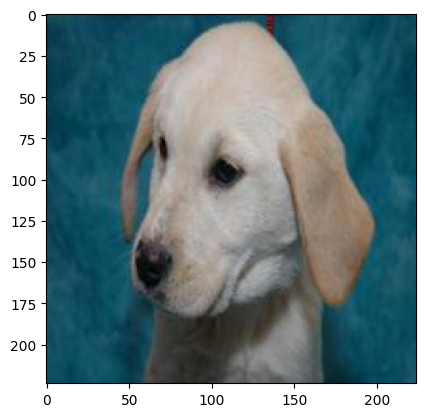

In [ ]:
# display resized dog image
img = mpimg.imread('/content/image_resized/dog.2994.jpg')
imgplt = plt.imshow(img)
plt.show()

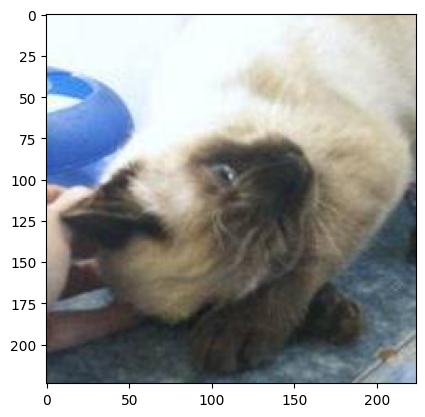

In [ ]:
# display resized cat image
img = mpimg.imread('/content/image_resized/cat.7323.jpg')
imgplt = plt.imshow(img)
plt.show()

Creating labels for resized images of dogs and cats

Cat --> 0

Dog --> 1

In [ ]:
# creaing a for loop to assign labels
filenames = os.listdir('/content/image_resized/')


labels = []

for i in range(2000):

  file_name = filenames[i]
  label = file_name[0:3]

  if label == 'dog':
    labels.append(1)

  else:
    labels.append(0)

In [ ]:
print(filenames[0:5])
print(len(filenames))

['dog.6504.jpg', 'cat.8895.jpg', 'dog.4758.jpg', 'cat.12147.jpg', 'cat.7323.jpg']
2000


In [ ]:
print(labels[0:5])
print(len(labels))

[1, 0, 1, 0, 0]
2000


In [ ]:
# counting the images of dogs and cats out of 2000 images
values, counts = np.unique(labels, return_counts=True)
print(values)
print(counts)

[0 1]
[ 979 1021]


Converting all the resized images to numpy arrays

In [ ]:
import cv2
import glob

In [ ]:
image_directory = '/content/image_resized/'
image_extension = ['png', 'jpg']

files = []

[files.extend(glob.glob(image_directory + '*.' + e)) for e in image_extension]

dog_cat_images = np.asarray([cv2.imread(file) for file in files])

In [ ]:
print(dog_cat_images)

[[[[157 161 149]
   [157 161 149]
   [157 161 149]
   ...
   [175 191 204]
   [175 190 206]
   [173 188 204]]

  [[159 163 151]
   [159 163 151]
   [159 163 151]
   ...
   [174 190 203]
   [175 190 206]
   [173 188 204]]

  [[160 164 152]
   [160 164 152]
   [160 164 152]
   ...
   [174 190 203]
   [174 189 205]
   [173 188 204]]

  ...

  [[193 202 205]
   [194 203 206]
   [196 205 208]
   ...
   [118 106 104]
   [120 109 105]
   [120 109 105]]

  [[197 206 209]
   [198 207 210]
   [199 208 211]
   ...
   [115 103 101]
   [118 107 103]
   [120 109 105]]

  [[201 210 213]
   [201 210 213]
   [201 210 213]
   ...
   [113 101  99]
   [118 107 103]
   [120 109 105]]]


 [[[230 132  60]
   [229 133  57]
   [236 139  59]
   ...
   [255 177 100]
   [246 168  91]
   [236 158  81]]

  [[240 142  70]
   [235 138  64]
   [235 138  58]
   ...
   [244 166  89]
   [245 167  90]
   [247 169  92]]

  [[242 144  72]
   [236 139  65]
   [236 139  59]
   ...
   [244 166  89]
   [247 169  92]
   [251 173

In [ ]:
type(dog_cat_images)

numpy.ndarray

In [ ]:
print(dog_cat_images.shape)

(2000, 224, 224, 3)


In [ ]:
X = dog_cat_images
Y = np.asarray(labels)

Train Test Split

In [ ]:
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=2)

In [ ]:
print(X.shape, X_train.shape, X_test.shape)

(2000, 224, 224, 3) (1600, 224, 224, 3) (400, 224, 224, 3)


1600 --> training images

400 --> test images

In [ ]:
# scaling the data
X_train_scaled = X_train/255

X_test_scaled = X_test/255

In [ ]:
print(X_train_scaled)

[[[[0.09803922 0.24313725 0.2745098 ]
   [0.10196078 0.24705882 0.27843137]
   [0.10588235 0.25098039 0.28235294]
   ...
   [0.09019608 0.21176471 0.24705882]
   [0.08627451 0.20784314 0.24313725]
   [0.08235294 0.20392157 0.23921569]]

  [[0.09803922 0.24313725 0.2745098 ]
   [0.10196078 0.24705882 0.27843137]
   [0.10588235 0.25098039 0.28235294]
   ...
   [0.09019608 0.21176471 0.24705882]
   [0.08627451 0.20784314 0.24313725]
   [0.08627451 0.20784314 0.24313725]]

  [[0.10196078 0.24313725 0.28235294]
   [0.10196078 0.24313725 0.28235294]
   [0.10588235 0.24705882 0.28627451]
   ...
   [0.09019608 0.20784314 0.25098039]
   [0.09019608 0.20784314 0.25098039]
   [0.09019608 0.20784314 0.25098039]]

  ...

  [[0.11372549 0.21176471 0.2745098 ]
   [0.13333333 0.23137255 0.29411765]
   [0.16078431 0.25882353 0.32156863]
   ...
   [0.         0.21176471 0.65882353]
   [0.         0.21568627 0.65098039]
   [0.         0.21960784 0.64705882]]

  [[0.12941176 0.21960784 0.28235294]
   [0.1

Building the Neural Network

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten

# Define the model
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(2, activation='softmax')  # Assuming binary classification
])

# Print the model summary
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 64)        0         
 g2D)                                                            
                                                                 
 flatten (Flatten)           (None, 186624)            0         
                                                                 
 dense (Dense)               (None, 128)               2

In [ ]:
mobilenet_model = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4'

pretrained_model = hub.KerasLayer(mobilenet_model, input_shape=(224,224,3), trainable=False)

In [ ]:
num_of_classes = 2
model = tf.keras.Sequential([
    pretrained_model,
    tf.keras.layers.Dense(num_of_classes)
])
model.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense_2 (Dense)             (None, 2)                 2562      
                                                                 
Total params: 2260546 (8.62 MB)
Trainable params: 2562 (10.01 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [ ]:
model.compile(
    optimizer = 'adam',
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics = ['acc']
)

In [ ]:
model.fit(X_train_scaled, Y_train, epochs=5)

Epoch 1/5
50/50 [==============================] - 68s 1s/step - loss: 0.2206 - acc: 0.9094
Epoch 2/5
50/50 [==============================] - 63s 1s/step - loss: 0.0871 - acc: 0.9706
Epoch 3/5
50/50 [==============================] - 63s 1s/step - loss: 0.0664 - acc: 0.9794
Epoch 4/5
50/50 [==============================] - 68s 1s/step - loss: 0.0647 - acc: 0.9787
Epoch 5/5
50/50 [==============================] - 65s 1s/step - loss: 0.0471 - acc: 0.9881


In [ ]:
score, acc = model.evaluate(X_test_scaled, Y_test)
print('Test Loss =', score)
print('Test Accuracy =', acc)

13/13 [==============================] - 19s 1s/step - loss: 0.0521 - acc: 0.9750
Test Loss = 0.052052076905965805
Test Accuracy = 0.9750000238418579


Predictive System

Path of the image to be predicted: /content/dog.jpeg


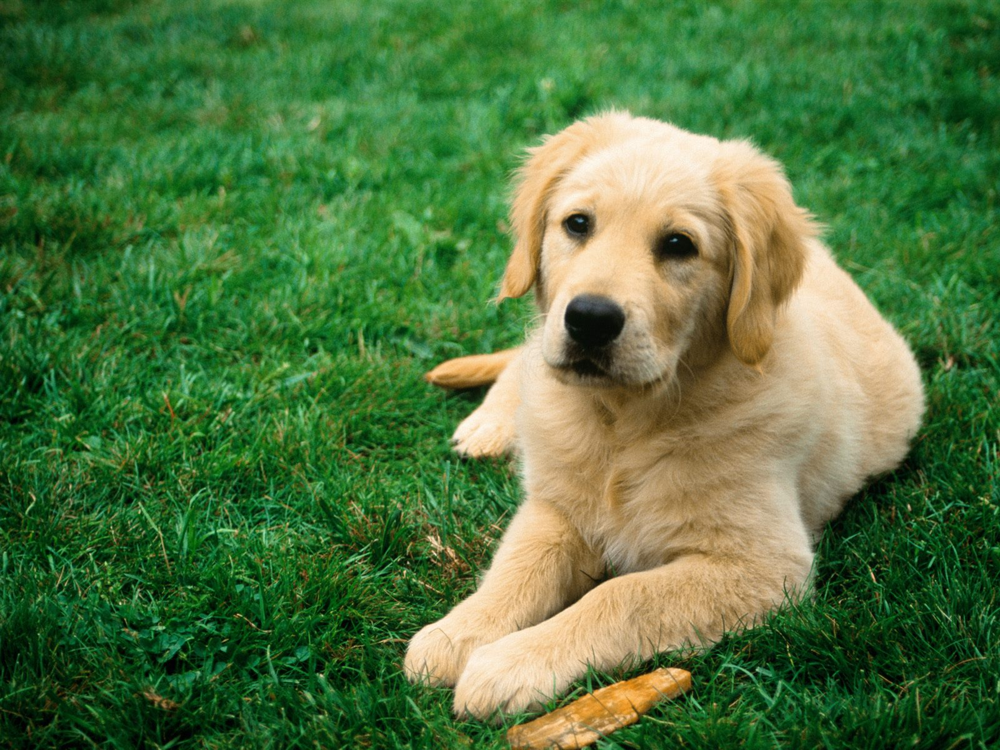

1/1 [==============================] - 1s 1s/step
[[-4.592483   3.7096295]]
1
The image represents a Dog


In [ ]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')

Path of the image to be predicted: /content/cat.jpg


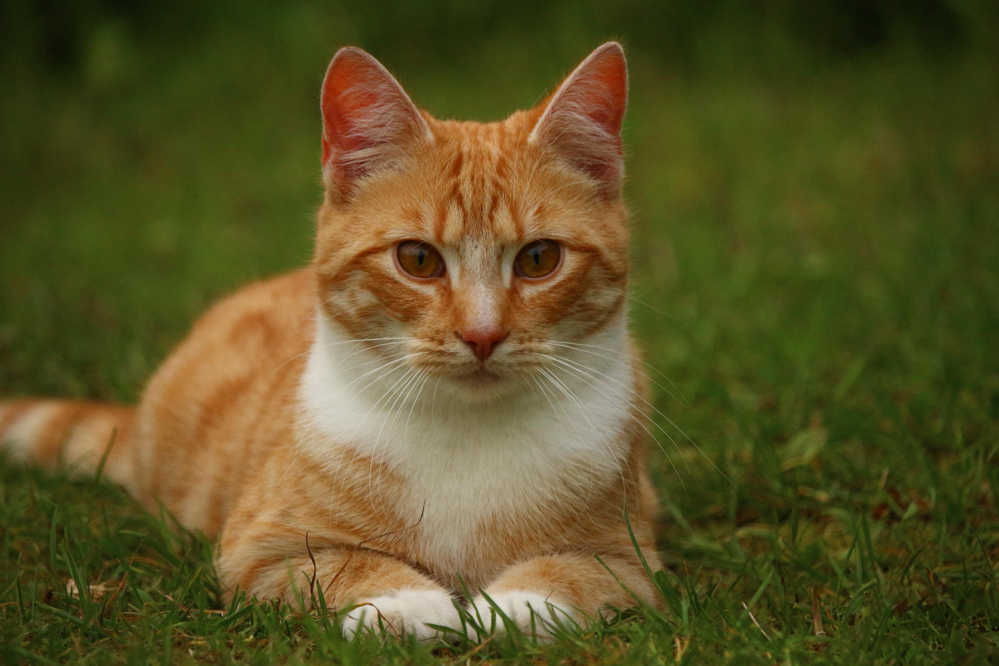

1/1 [==============================] - 0s 378ms/step
[[ 3.1037254 -1.1356605]]
0
The image represents a Cat


In [ ]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')